In [28]:
import pandas as pd
import nltk
import plotly.express as px
import matplotlib.pyplot as plt

In [2]:
# %pip install chardet
# import chardet

# file_path = "pls_isl_conflict_comments.csv"

# with open(file_path, 'rb') as f:
#     result = chardet.detect(f.read())  # Guess the encoding

# print("Detected Encoding:", result['encoding'])

### Loading the dateset

In [3]:
df = pd.read_csv("pls_isl_conflict_comments.csv", encoding=" ISO-8859-1 ",error_bad_lines=False)
df

C:\Users\nares\AppData\Local\Temp\ipykernel_16892\4292602964.py:1: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df = pd.read_csv("pls_isl_conflict_comments.csv", encoding=" ISO-8859-1 ",error_bad_lines=False)
Skipping line 4223: expected 5 fields, saw 7
Skipping line 8686: expected 5 fields, saw 6
Skipping line 11430: expected 5 fields, saw 9
Skipping line 12751: expected 5 fields, saw 6
Skipping line 12932: expected 5 fields, saw 6
Skipping line 29740: expected 5 fields, saw 11
Skipping line 30051: expected 5 fields, saw 112
Skipping line 30696: expected 5 fields, saw 8
Skipping line 30988: expected 5 fields, saw 7
Skipping line 32658: expected 5 fields, saw 6
Skipping line 36002: expected 5 fields, saw 6
Skipping line 36382: expected 5 fields, saw 6
Skipping line 36441: expected 5 fields, saw 6
Skipping line 37320: expected 5 fields, saw 10

Skipping line 393388: expected 5 fields, saw 6
S

,comment_id,score,self_text,subreddit,created_time
0,k5480sx,1,Exactly! I can remember the humanitarian aid s...,worldnews,16-10-2023 19:39
1,k547q14,1,*We are the only part of the World that has Fr...,Palestine,16-10-2023 19:36
2,k547elf,1,"I dont make Israeli strategy, nor am I Israel...",worldnews,16-10-2023 19:34
3,k54742r,1,These people didn't vote Hamas in or something...,worldnews,16-10-2023 19:32
4,k5473zi,1,We don't care what you do. We just want to liv...,worldnews,16-10-2023 19:32
...,...,...,...,...,...
1359048,k3sdwfc,42,US. This is bullshit,Palestine,07-10-2023 05:20
1359049,k3sdixt,1,I am in the United States and it has the dotte...,Palestine,07-10-2023 05:17
1359050,k3sccp2,54,In which country are you?\nSometimes maps adap...,Palestine,07-10-2023 05:08
1359051,k3ritvj,116,You can't give up on something you only preten...,worldnews,07-10-2023 01:46


### TASK
- remove column comment_id,score
- remove rows with null value in self_text column
- replace null data in subreddit column with "unknown"
- change created_time datatype --> pd.datetime
- keeping only date value removing time


In [4]:
df = df.drop(["comment_id","score"], axis=1)
df

,self_text,subreddit,created_time
0,Exactly! I can remember the humanitarian aid s...,worldnews,16-10-2023 19:39
1,*We are the only part of the World that has Fr...,Palestine,16-10-2023 19:36
2,"I dont make Israeli strategy, nor am I Israel...",worldnews,16-10-2023 19:34
3,These people didn't vote Hamas in or something...,worldnews,16-10-2023 19:32
4,We don't care what you do. We just want to liv...,worldnews,16-10-2023 19:32
...,...,...,...
1359048,US. This is bullshit,Palestine,07-10-2023 05:20
1359049,I am in the United States and it has the dotte...,Palestine,07-10-2023 05:17
1359050,In which country are you?\nSometimes maps adap...,Palestine,07-10-2023 05:08
1359051,You can't give up on something you only preten...,worldnews,07-10-2023 01:46


In [5]:
df.info()
df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1359053 entries, 0 to 1359052
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   self_text     730294 non-null  object
 1   subreddit     254711 non-null  object
 2   created_time  189327 non-null  object
dtypes: object(3)
memory usage: 31.1+ MB


self_text        628759
subreddit       1104342
created_time    1169726
dtype: int64

In [6]:
df.dropna(subset=["self_text"],axis=0,inplace=True)
df

,self_text,subreddit,created_time
0,Exactly! I can remember the humanitarian aid s...,worldnews,16-10-2023 19:39
1,*We are the only part of the World that has Fr...,Palestine,16-10-2023 19:36
2,"I dont make Israeli strategy, nor am I Israel...",worldnews,16-10-2023 19:34
3,These people didn't vote Hamas in or something...,worldnews,16-10-2023 19:32
4,We don't care what you do. We just want to liv...,worldnews,16-10-2023 19:32
...,...,...,...
1359048,US. This is bullshit,Palestine,07-10-2023 05:20
1359049,I am in the United States and it has the dotte...,Palestine,07-10-2023 05:17
1359050,In which country are you?\nSometimes maps adap...,Palestine,07-10-2023 05:08
1359051,You can't give up on something you only preten...,worldnews,07-10-2023 01:46


In [7]:
df.isnull().sum()

self_text            0
subreddit       475584
created_time    540967
dtype: int64

In [8]:
df["subreddit"].fillna("unknown",inplace=True)
df.isnull().sum()

self_text            0
subreddit            0
created_time    540967
dtype: int64

#### Extracting only date 

In [9]:
df["created_time"] = pd.to_datetime(df["created_time"], format="%d-%m-%Y %H:%M",errors="coerce")
df["created_time"] = df["created_time"].dt.date
df

,self_text,subreddit,created_time
0,Exactly! I can remember the humanitarian aid s...,worldnews,2023-10-16
1,*We are the only part of the World that has Fr...,Palestine,2023-10-16
2,"I dont make Israeli strategy, nor am I Israel...",worldnews,2023-10-16
3,These people didn't vote Hamas in or something...,worldnews,2023-10-16
4,We don't care what you do. We just want to liv...,worldnews,2023-10-16
...,...,...,...
1359048,US. This is bullshit,Palestine,2023-10-07
1359049,I am in the United States and it has the dotte...,Palestine,2023-10-07
1359050,In which country are you?\nSometimes maps adap...,Palestine,2023-10-07
1359051,You can't give up on something you only preten...,worldnews,2023-10-07


In [10]:
df["subreddit"].value_counts()

unknown                                                                                                                                           475584
5-5(5+52 5(5 5 55                                                                                                                               65362
IsraelPalestine                                                                                                                                    52533
worldnews                                                                                                                                          36179
AskMiddleEast                                                                                                                                      28047
CombatFootage                                                                                                                                      27865
PublicFreakout                                                                    

### Data collection Info
- max data from unknown subreddit. No record of subreddit in dataset
- IsraelPalestine, Worldnews,
AskmiddleEast are top 3 subreddit from where data is collected
                                                                                                                                                                                                                                                                                                                                                                                                                         

In [11]:
import texthero as hero

In [12]:
df['self_text'] = hero.clean(df['self_text'])
df

c:\Users\nares\AppData\Local\Programs\Python\Python311\Lib\site-packages\texthero\preprocessing.py:46: FutureWarning: The default value of regex will change from True to False in a future version.
  return input.str.replace(r"^\d+\s|\s\d+\s|\s\d+$", " ")
c:\Users\nares\AppData\Local\Programs\Python\Python311\Lib\site-packages\texthero\preprocessing.py:81: FutureWarning: The default value of regex will change from True to False in a future version.
  return input.str.replace(pat, '')


,self_text,subreddit,created_time
0,exactly remember humanitarian aid streaming st...,worldnews,2023-10-16
1,part world freedom speech person exercises fre...,Palestine,2023-10-16
2, make israeli strategy israeli jewish  suppo...,worldnews,2023-10-16
3,people vote hamas something exactly much hamas...,worldnews,2023-10-16
4,care want live world literally impossible terr...,worldnews,2023-10-16
...,...,...,...
1359048,us bullshit,Palestine,2023-10-07
1359049,united states dotted west bank gaza strip alth...,Palestine,2023-10-07
1359050,country sometimes maps adapt countries view ma...,Palestine,2023-10-07
1359051,give something pretended support cynical reasons,worldnews,2023-10-07


In [13]:
from nltk.sentiment import SentimentIntensityAnalyzer
sent = SentimentIntensityAnalyzer()

In [14]:
polarity = [round(sent.polarity_scores(i)['compound'], 2) for i in df['self_text']]
df['sentiment_score'] = polarity
df

,self_text,subreddit,created_time,sentiment_score
0,exactly remember humanitarian aid streaming st...,worldnews,2023-10-16,0.36
1,part world freedom speech person exercises fre...,Palestine,2023-10-16,0.81
2, make israeli strategy israeli jewish  suppo...,worldnews,2023-10-16,0.88
3,people vote hamas something exactly much hamas...,worldnews,2023-10-16,-0.56
4,care want live world literally impossible terr...,worldnews,2023-10-16,-0.98
...,...,...,...,...
1359048,us bullshit,Palestine,2023-10-07,-0.59
1359049,united states dotted west bank gaza strip alth...,Palestine,2023-10-07,0.42
1359050,country sometimes maps adapt countries view ma...,Palestine,2023-10-07,0.03
1359051,give something pretended support cynical reasons,worldnews,2023-10-07,0.03


In [15]:
print("MINIMUM sentiment score: ",df["sentiment_score"].min())
print("MAXIMUM sentiment score: ",df["sentiment_score"].max())
print("AVG. sentiment score: ",df["sentiment_score"].mean())

MINIMUM sentiment score:  -1.0
MAXIMUM sentiment score:  1.0
AVG. sentiment score:  0.050620051650431215


In [16]:
def sentiment_label(score):
        if (score>0):
            return 'Positive'
        elif (score<0):
            return 'Negative'
        else:
            return 'Neutral'

df["sentiment_label"] = df['sentiment_score'].apply(sentiment_label)

In [17]:
df

,self_text,subreddit,created_time,sentiment_score,sentiment_label
0,exactly remember humanitarian aid streaming st...,worldnews,2023-10-16,0.36,Positive
1,part world freedom speech person exercises fre...,Palestine,2023-10-16,0.81,Positive
2, make israeli strategy israeli jewish  suppo...,worldnews,2023-10-16,0.88,Positive
3,people vote hamas something exactly much hamas...,worldnews,2023-10-16,-0.56,Negative
4,care want live world literally impossible terr...,worldnews,2023-10-16,-0.98,Negative
...,...,...,...,...,...
1359048,us bullshit,Palestine,2023-10-07,-0.59,Negative
1359049,united states dotted west bank gaza strip alth...,Palestine,2023-10-07,0.42,Positive
1359050,country sometimes maps adapt countries view ma...,Palestine,2023-10-07,0.03,Positive
1359051,give something pretended support cynical reasons,worldnews,2023-10-07,0.03,Positive


In [18]:
fig = px.pie(df,names="sentiment_label",title="Distribution of Sentiment label")
fig.show()

In [27]:
from wordcloud import WordCloud
wc = WordCloud(width=500,height=500,min_font_size=10,background_color='white')

### Negative Sentiment Wordcloud

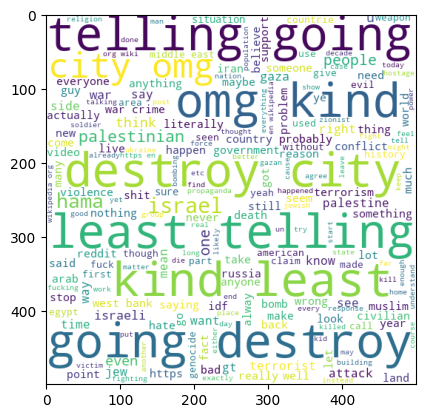

In [29]:
Neg_text = wc.generate(df[df['sentiment_label']=="Negative"]['self_text'].str.cat(sep=" "))
plt.imshow(Neg_text)

### Positive Sentiment word cloud

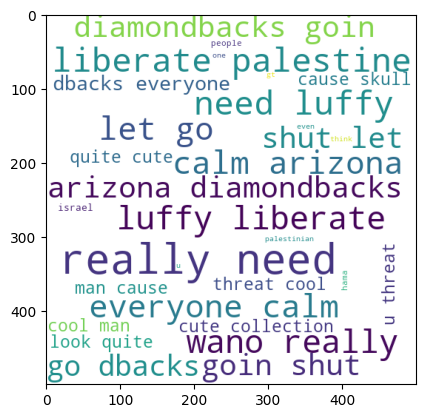

In [33]:
Positive_text = wc.generate(df[df['sentiment_label']=="Positive"]['self_text'].str.cat(sep=" "))
plt.imshow(Positive_text)

### Neutral sentiment word cloud

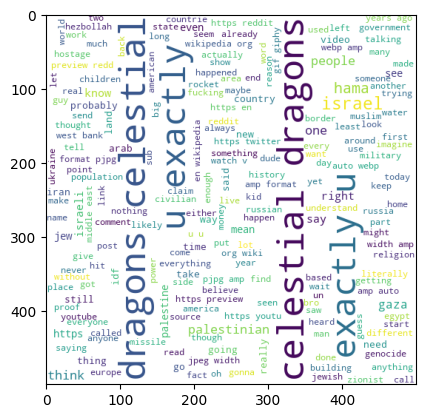

In [32]:
Neutral_text = wc.generate(df[df["sentiment_label"]=="Neutral"]["self_text"].str.cat(sep=" "))
plt.imshow(Neutral_text)

In [37]:
fig=px.histogram(df['created_time'], x="created_time", title="Creation Time Lapse",color='created_time')
fig.show()

### Maximum comment was done on Oct 14,2023